# Visualizing and understanding significant differences in neuron activations for the trained model in another notebook

In [1]:
import pandas as pd
import numpy as np

# df_activations = pd.read_csv('./data/activations.csv')
# df_activations = pd.read_pickle('./data/activations.pkl')
df_activations = pd.read_pickle('./data/activations-train.pkl')
df_activations.shape

(11320, 67)

In [2]:
df_activations.head()

,categories,pred,true,neuron_1,neuron_2,neuron_3,neuron_4,neuron_5,neuron_6,neuron_7,...,neuron_55,neuron_56,neuron_57,neuron_58,neuron_59,neuron_60,neuron_61,neuron_62,neuron_63,neuron_64
0,[1950s_romantic_comedy_films],2,1,0.424084,0.000000,0.452278,0.291724,0.459992,0.000000,0.273046,...,0.633797,0.498378,0.000000,0.226697,0.000000,0.686606,0.093570,0.169570,0.309435,0.232526
1,[Underwater_action_films],2,2,0.730564,0.000000,0.170598,0.376262,0.722307,0.000000,0.631108,...,1.017032,1.244231,0.000000,0.678127,0.000000,1.110830,0.000000,0.000000,0.184850,0.631119
2,"[Cinema_of_England, 2020_films]",2,2,0.560855,0.000000,0.538489,0.277255,0.602126,0.000000,0.223799,...,0.787969,0.434829,0.000000,0.164589,0.085680,0.996756,0.633387,0.179146,0.461960,0.178437
3,"[American_films, 1952_films, Films_directed_by...",0,1,0.311678,0.361044,0.750502,0.000000,0.000000,0.398532,0.000000,...,0.442646,0.000000,0.390990,0.000000,0.513794,0.310550,1.387266,0.469640,0.747502,0.000000
4,"[Apocalyptic_films, Speculative_fiction_films,...",1,1,0.288678,0.278253,0.685035,0.000000,0.031736,0.251514,0.000000,...,0.539713,0.000000,0.254578,0.000000,0.678507,0.414084,1.333957,0.365494,0.743808,0.000000


In [3]:
df_activations.to_json('./data/data.json')

In [4]:
df_activations.describe()

,pred,true,neuron_1,neuron_2,neuron_3,neuron_4,neuron_5,neuron_6,neuron_7,neuron_8,...,neuron_55,neuron_56,neuron_57,neuron_58,neuron_59,neuron_60,neuron_61,neuron_62,neuron_63,neuron_64
count,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,...,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000,11320.000000
mean,0.900795,0.911572,0.351617,0.254362,0.587871,0.236432,0.294778,0.448909,0.132937,0.185228,...,0.518814,0.218555,0.400909,0.130058,0.425172,0.539357,0.992281,0.513448,0.635403,0.123101
std,0.794761,0.828766,0.271169,0.368086,0.449143,0.315483,0.292325,0.679850,0.203873,0.212957,...,0.407480,0.379453,0.552039,0.223455,0.357445,0.466813,0.636384,0.661044,0.428797,0.203950
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.303191,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.028687,0.000000,0.515249,0.049136,0.349372,0.000000
50%,1.000000,1.000000,0.406202,0.021398,0.486815,0.149618,0.270241,0.047359,0.000000,0.103185,...,0.597422,0.000000,0.045229,0.000000,0.444115,0.610713,1.015144,0.228309,0.523876,0.000000
75%,2.000000,2.000000,0.583345,0.431989,0.690362,0.313908,0.545045,0.722925,0.231913,0.336756,...,0.867932,0.341560,0.736448,0.200778,0.706042,0.932479,1.344925,0.676782,0.755241,0.204197
max,2.000000,2.000000,0.910211,1.487581,2.088205,1.376094,1.047652,2.648360,0.960794,0.946525,...,1.584331,1.984985,1.736867,1.223305,1.246049,1.741151,2.573703,2.620119,2.108414,1.024305


In [5]:
ucats = []
for cats in df_activations.categories:
    for c in cats:
        if c not in ucats:
            ucats.append(c)

In [6]:
categories = []
occ = []
for c in ucats:
#     print(c, len(df_activations[df_activations.categories.apply(lambda x: c in x)]))
    categories.append(c)
    occ.append(len(df_activations[df_activations.categories.apply(lambda x: c in x)]))

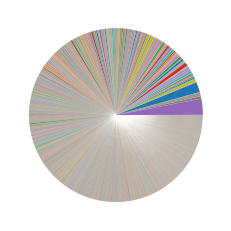

In [7]:
import matplotlib.pyplot as plt
import seaborn as sns

In [8]:
df_activations_s = df_activations.copy()
for col in df_activations:
    if "neuron" in col:
        df_activations_s[col] = (df_activations[col] - df_activations[col].mean()) / df_activations[col].std()

df_activations_s.describe()

,pred,true,neuron_1,neuron_2,neuron_3,neuron_4,neuron_5,neuron_6,neuron_7,neuron_8,...,neuron_55,neuron_56,neuron_57,neuron_58,neuron_59,neuron_60,neuron_61,neuron_62,neuron_63,neuron_64
count,11320.000000,11320.000000,11320.000000,1.132000e+04,11320.000000,11320.000000,1.132000e+04,1.132000e+04,1.132000e+04,1.132000e+04,...,11320.000000,1.132000e+04,1.132000e+04,1.132000e+04,11320.000000,11320.000000,11320.000000,1.132000e+04,1.132000e+04,11320.000000
mean,0.900795,0.911572,-0.000002,-4.916409e-07,0.000001,-0.000002,-3.445064e-07,2.564711e-07,-5.112310e-07,-4.553911e-07,...,0.000002,-4.242882e-08,1.210443e-07,1.885129e-07,-0.000001,-0.000004,0.000002,-7.631679e-07,4.768898e-08,-0.000001
std,0.794761,0.828766,0.999989,1.000007e+00,1.000001,0.999973,9.999873e-01,9.999777e-01,1.000003e+00,1.000030e+00,...,0.999999,1.000019e+00,1.000006e+00,1.000044e+00,1.000000,0.999995,0.999999,1.000007e+00,1.000000e+00,0.999948
min,0.000000,0.000000,-1.296672,-6.910405e-01,-1.308873,-0.749426,-1.008393e+00,-6.603059e-01,-6.520557e-01,-8.697917e-01,...,-1.273226,-5.759732e-01,-7.262333e-01,-5.820290e-01,-1.189475,-1.155401,-1.559248,-7.767223e-01,-1.481827e+00,-0.603583
25%,0.000000,0.000000,-1.296672,-6.910405e-01,-0.633828,-0.749426,-1.008393e+00,-6.603059e-01,-6.520557e-01,-8.697917e-01,...,-1.273226,-5.759732e-01,-7.262333e-01,-5.820290e-01,-1.109221,-1.155401,-0.749598,-7.023915e-01,-6.670546e-01,-0.603583
50%,1.000000,1.000000,0.201294,-6.329083e-01,-0.224997,-0.275176,-8.393837e-02,-5.906442e-01,-6.520557e-01,-3.852572e-01,...,0.192913,-5.759732e-01,-6.443031e-01,-5.820290e-01,0.052996,0.152859,0.035927,-4.313462e-01,-2.600912e-01,-0.603583
75%,2.000000,2.000000,0.854552,4.825676e-01,0.228193,0.245581,8.561278e-01,4.030546e-01,4.854776e-01,7.115453e-01,...,0.856772,3.241640e-01,6.078174e-01,3.164852e-01,0.785773,0.842140,0.554136,2.470844e-01,2.794759e-01,0.397628
max,2.000000,2.000000,2.059947,3.350356e+00,3.340441,3.612433,2.575471e+00,3.235203e+00,4.060650e+00,3.574895e+00,...,2.614894,4.655198e+00,2.420042e+00,4.892462e+00,2.296515,2.574464,2.485011,3.186882e+00,3.435221e+00,4.418744


Rechercher les catégories les plus populaires

In [9]:
all_categories = {}


df_cat = df_activations_s.categories
for cats in df_cat:
    for cat in cats:
        if cat not in all_categories.keys():
            all_categories[f"{cat}"] = 1
        else:
            all_categories[f"{cat}"] += 1

print(len(all_categories))
print({k: v for k, v in all_categories.items() if v > 100})

11363
{'American_films': 1134, 'Cinema_of_the_United_States': 175, 'English-language_films': 726, 'British_films': 192, 'Warner_Bros._films': 125, 'Films_based_on_American_novels': 139, 'North_American_films_by_country': 164, 'Films_by_country': 239, 'Films_by_language': 137, 'Works_by_American_people': 158, 'Films_by_director': 197, 'English-language_works': 108, 'Films_set_in_New_York_City': 132, 'American_films_by_studio': 149, 'Film_scores_by_composer': 124, 'Films_by_American_directors': 109, 'American_drama_films': 148, 'French_films': 186, 'American_black-and-white_films': 174, '20th_Century_Fox_films': 113, 'American_independent_films': 135, 'Metro-Goldwyn-Mayer_films': 120, 'Films_shot_in_Los_Angeles': 113}


In [10]:
def getCatDF(cat): 
    return df_activations_s[df_activations_s.categories.apply(lambda x: cat in x)]

def get_popular_cat(n=100):
    all_categories = {}


    df_cat = df_activations_s.categories
    for cats in df_cat:
        for cat in cats:
            if cat not in all_categories.keys():
                all_categories[f"{cat}"] = 1
            else:
                all_categories[f"{cat}"] += 1
                
    dict_pop_cat = {k: v for k, v in all_categories.items() if v > n}
    return [x for x in dict_pop_cat.keys()]

get_popular_cat(n=100)

['American_films',
 'Cinema_of_the_United_States',
 'English-language_films',
 'British_films',
 'Warner_Bros._films',
 'Films_based_on_American_novels',
 'North_American_films_by_country',
 'Films_by_country',
 'Films_by_language',
 'Works_by_American_people',
 'Films_by_director',
 'English-language_works',
 'Films_set_in_New_York_City',
 'American_films_by_studio',
 'Film_scores_by_composer',
 'Films_by_American_directors',
 'American_drama_films',
 'French_films',
 'American_black-and-white_films',
 '20th_Century_Fox_films',
 'American_independent_films',
 'Metro-Goldwyn-Mayer_films',
 'Films_shot_in_Los_Angeles']

In [11]:
getCatDF("French_films")

,categories,pred,true,neuron_1,neuron_2,neuron_3,neuron_4,neuron_5,neuron_6,neuron_7,...,neuron_55,neuron_56,neuron_57,neuron_58,neuron_59,neuron_60,neuron_61,neuron_62,neuron_63,neuron_64
83,"[Censorship_in_Italy, Erotic_romance_films, En...",0,0,-1.296672,1.077671,1.088643,0.851263,-1.008393,1.154814,-0.652056,...,-1.273226,-0.575973,1.728927,-0.582029,0.073745,-1.155401,1.063861,1.623576,1.136609,-0.603583
169,[French_films],1,1,0.153218,-0.691040,0.039497,-0.079291,0.305861,-0.574624,-0.186713,...,0.037971,-0.280546,-0.667848,-0.582029,-1.189475,0.154713,-0.755206,-0.362786,-0.450347,-0.376346
206,"[Films_about_con_artists, Films_directed_by_Cl...",1,1,0.478051,-0.691040,-0.166025,-0.068524,0.622146,-0.660306,0.133551,...,0.273110,-0.061912,-0.726233,-0.264283,-1.189475,0.398304,-0.814571,-0.517928,-0.589130,0.033825
219,[French_films],0,0,-1.296672,0.353335,-0.924749,-0.749426,-1.008393,0.167372,-0.652056,...,-1.273226,-0.575973,0.324748,-0.582029,0.766152,-1.155401,-0.131687,-0.085886,-0.547255,-0.603583
223,"[French_films, Films_by_Turkish_directors]",2,2,0.540394,-0.691040,-0.550384,0.173823,0.892749,-0.660306,0.983777,...,0.444524,0.894139,-0.726233,0.791713,-1.189475,0.529096,-1.456143,-0.695902,-0.954730,0.954172
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10918,"[2004_comedy_films, 2004_films, French_films]",1,0,0.096929,-0.691040,0.011393,-0.077640,0.256763,-0.559493,-0.168958,...,-0.006492,-0.294500,-0.654530,-0.582029,-1.189475,0.101451,-0.795108,-0.361817,-0.481216,-0.388698
10952,[French_films],1,1,0.585521,-0.691040,-0.752910,-0.749426,-0.400684,-0.660306,-0.652056,...,1.081468,-0.575973,-0.726233,-0.582029,1.622657,0.452169,0.163910,-0.776722,-0.181768,-0.510080
11114,"[English-language_French_films, Polish_science...",1,1,0.576191,-0.691040,-0.269942,-0.749426,0.103743,-0.660306,-0.616076,...,1.018392,-0.575973,-0.726233,-0.558374,0.962065,0.689568,0.304969,-0.681309,-0.033351,-0.603583
11142,"[French_films, Works_by_American_people, 2019_...",2,2,0.730764,-0.691040,-0.224263,0.205644,0.736011,-0.660306,1.017483,...,0.641969,1.331516,-0.726233,0.655003,-1.189475,0.696659,-1.328064,-0.493965,-0.533510,0.921350


In [12]:
pop_cat = get_popular_cat(100)

cats = {}
for cat in pop_cat:
    cdf = getCatDF(cat)
    cats[cat] = {"meanpred": cdf.pred.mean(), "stdpred": cdf.pred.std(), "meanreal": cdf.true.mean(), "stdreal": cdf.true.std()}
    cats[cat]["mae"] = abs(cdf.pred-cdf.true).sum()/len(cdf)
    
catsdf = pd.DataFrame(cats).T
catsdf

,meanpred,stdpred,meanreal,stdreal,mae
American_films,0.845679,0.786017,0.868607,0.821932,0.114638
Cinema_of_the_United_States,0.857143,0.800246,0.897143,0.809954,0.131429
English-language_films,0.957300,0.792792,0.962810,0.822105,0.107438
British_films,0.958333,0.836556,0.953125,0.857911,0.088542
Warner_Bros._films,0.648000,0.732385,0.640000,0.755624,0.088000
Films_based_on_American_novels,0.906475,0.700849,0.964029,0.783989,0.158273
North_American_films_by_country,0.786585,0.812217,0.762195,0.789990,0.085366
Films_by_country,0.937238,0.772583,0.995816,0.822468,0.158996
Films_by_language,0.919708,0.738225,0.956204,0.812301,0.197080
Works_by_American_people,0.765823,0.807353,0.816456,0.858369,0.126582


In [13]:
import glob as glob
import plotly.express as px
import plotly.graph_objects as go

In [14]:
def get_activ_for_cat(category):
    return getCatDF(category).iloc[:, 3:]

def get_mean_activ_for_cat(category):
    return pd.DataFrame(get_activ_for_cat(category).mean()).T

c = 'Films_by_director'
get_mean_activ_for_cat(c)

,neuron_1,neuron_2,neuron_3,neuron_4,neuron_5,neuron_6,neuron_7,neuron_8,neuron_9,neuron_10,...,neuron_55,neuron_56,neuron_57,neuron_58,neuron_59,neuron_60,neuron_61,neuron_62,neuron_63,neuron_64
0,0.057037,0.01117,-0.013527,-0.014589,-0.011839,0.008933,0.01186,0.086407,-0.001927,0.008547,...,0.056101,0.020565,0.00655,0.033532,0.08783,0.026469,0.033483,-0.008277,0.017909,0.038566


In [15]:
get_activ_for_cat('French_films')

,neuron_1,neuron_2,neuron_3,neuron_4,neuron_5,neuron_6,neuron_7,neuron_8,neuron_9,neuron_10,...,neuron_55,neuron_56,neuron_57,neuron_58,neuron_59,neuron_60,neuron_61,neuron_62,neuron_63,neuron_64
83,-1.296672,1.077671,1.088643,0.851263,-1.008393,1.154814,-0.652056,-0.869792,1.737952,-0.557207,...,-1.273226,-0.575973,1.728927,-0.582029,0.073745,-1.155401,1.063861,1.623576,1.136609,-0.603583
169,0.153218,-0.691040,0.039497,-0.079291,0.305861,-0.574624,-0.186713,-0.694786,-0.707213,-0.217363,...,0.037971,-0.280546,-0.667848,-0.582029,-1.189475,0.154713,-0.755206,-0.362786,-0.450347,-0.376346
206,0.478051,-0.691040,-0.166025,-0.068524,0.622146,-0.660306,0.133551,-0.272674,-0.707213,-0.010735,...,0.273110,-0.061912,-0.726233,-0.264283,-1.189475,0.398304,-0.814571,-0.517928,-0.589130,0.033825
219,-1.296672,0.353335,-0.924749,-0.749426,-1.008393,0.167372,-0.652056,-0.869792,0.528316,-0.557207,...,-1.273226,-0.575973,0.324748,-0.582029,0.766152,-1.155401,-0.131687,-0.085886,-0.547255,-0.603583
223,0.540394,-0.691040,-0.550384,0.173823,0.892749,-0.660306,0.983777,0.445026,-0.707213,1.114442,...,0.444524,0.894139,-0.726233,0.791713,-1.189475,0.529096,-1.456143,-0.695902,-0.954730,0.954172
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10918,0.096929,-0.691040,0.011393,-0.077640,0.256763,-0.559493,-0.168958,-0.744595,-0.707213,-0.181332,...,-0.006492,-0.294500,-0.654530,-0.582029,-1.189475,0.101451,-0.795108,-0.361817,-0.481216,-0.388698
10952,0.585521,-0.691040,-0.752910,-0.749426,-0.400684,-0.660306,-0.652056,1.224169,-0.707213,-0.557207,...,1.081468,-0.575973,-0.726233,-0.582029,1.622657,0.452169,0.163910,-0.776722,-0.181768,-0.510080
11114,0.576191,-0.691040,-0.269942,-0.749426,0.103743,-0.660306,-0.616076,0.474968,-0.707213,-0.557207,...,1.018392,-0.575973,-0.726233,-0.558374,0.962065,0.689568,0.304969,-0.681309,-0.033351,-0.603583
11142,0.730764,-0.691040,-0.224263,0.205644,0.736011,-0.660306,1.017483,0.680264,-0.707213,0.999164,...,0.641969,1.331516,-0.726233,0.655003,-1.189475,0.696659,-1.328064,-0.493965,-0.533510,0.921350


In [16]:
def get_activation_except_cat(category, popular_cat):
    df = pd.DataFrame()
    for cat in popular_cat:
        if cat != category:
            df = pd.concat([df, get_mean_activ_for_cat(cat)])
    
    return df      
    
def get_activations_raw_array(activations):
    raw_acts = []
    
    for cat in activations:
        for index, row in cat.iterrows():
            raw_acts.append(row[0])
    
    df = pd.DataFrame()
    df['activation'] = raw_acts
    return df

pd.DataFrame(get_activation_except_cat('French_films', pop_cat).mean()).T

,neuron_1,neuron_2,neuron_3,neuron_4,neuron_5,neuron_6,neuron_7,neuron_8,neuron_9,neuron_10,...,neuron_55,neuron_56,neuron_57,neuron_58,neuron_59,neuron_60,neuron_61,neuron_62,neuron_63,neuron_64
0,-0.008433,0.056954,0.057737,-0.000998,-0.053165,0.046304,-0.067454,-0.006251,0.056586,-0.071099,...,0.003382,-0.067436,0.052174,-0.06052,0.138386,-0.016593,0.112743,0.050116,0.088397,-0.063013


## Building Heatmaps for each category
https://plotly.com/python/heatmaps/

In [17]:
for cat in pop_cat:
    fig = px.imshow(pd.DataFrame(get_activ_for_cat(cat).mean()).T, title=f"Heatmap for {cat}", height=350)
    fig.show()

In [47]:
def get_act_heatmap_both_for_and_not_for_cat(category, show_above=True):
    
    df = get_activation_except_cat(category, pop_cat)
    df = pd.DataFrame(df.mean()).T
            
            
    # Plot heatmaps
    
#     df_mean_act = pd.DataFrame(arr_mean_act.mean())
    
#     fig = px.imshow(get_activation_for_cat(category).T.reset_index().rename(columns={'index': ''}), 
#                     title=f"Heatmap for category {category}", aspect='auto')
#     fig.show()
    
#     fig = px.imshow(df_mean_act.T, aspect='auto',
#                     title=f"Heatmap for all categories except {category}", height=350)
#     fig.show()

    if show_above:
        print(f"Heatmap for category {category}")
        data = [go.Heatmap(
#                 z=get_activation_for_cat(category, cat_activations).T, 
                z=get_mean_activ_for_cat(c), 
                zmin=-1, zmax=1,
                colorscale=['rgb(13, 204, 223)', 'rgb(0, 0, 0)', 'rgb(205, 255, 0)'], 
                reversescale=False, 
                colorbar=dict(thickness=20,
                                ticklen=3, tickcolor='white',
                                tickfont=dict(size=14, color='white')))]
        layout = go.Layout(template='none', height=300)
        fig = go.Figure(data=data, layout=layout)
        fig.show()

        print(f"Heatmap for all categories except {category}")
        data = [go.Heatmap(
                z=df, zmin=-1, zmax=1,
                colorscale=['rgb(13, 204, 223)', 'rgb(0, 0, 0)', 'rgb(205, 255, 0)'],
                reversescale=False, 
                colorbar=dict(thickness=20,
                                ticklen=3, tickcolor='white',
                                tickfont=dict(size=14, color='white')))]
        layout = go.Layout(template='none', height=300)
        fig = go.Figure(data=data, layout=layout)
        fig.show()
    
    
    diff_df = np.array(get_activ_for_cat(category).mean()) - np.array(df.T[0])
    
    print(f"Absolute difference between {category} and the other heatmaps")
    data = [go.Heatmap(
            z=pd.DataFrame(diff_df).T, 
            zmin=-1, zmax=1,
            colorscale=['rgb(13, 204, 223)', 'rgb(0, 0, 0)', 'rgb(205, 255, 0)'], 
            reversescale=False, 
            colorbar=dict(thickness=20,
                            ticklen=3, tickcolor='white',
                            tickfont=dict(size=14, color='white')))]
    layout = go.Layout(template='none', height=300)
    fig = go.Figure(data=data, layout=layout)
    fig.show()

In [48]:
for category in pop_cat:
        get_act_heatmap_both_for_and_not_for_cat(category, show_above=True)

Heatmap for category American_films


Heatmap for all categories except American_films


Absolute difference between American_films and the other heatmaps


Heatmap for category Cinema_of_the_United_States


Heatmap for all categories except Cinema_of_the_United_States


Absolute difference between Cinema_of_the_United_States and the other heatmaps


Heatmap for category English-language_films


Heatmap for all categories except English-language_films


Absolute difference between English-language_films and the other heatmaps


Heatmap for category British_films


Heatmap for all categories except British_films


Absolute difference between British_films and the other heatmaps


Heatmap for category Warner_Bros._films


Heatmap for all categories except Warner_Bros._films


Absolute difference between Warner_Bros._films and the other heatmaps


Heatmap for category Films_based_on_American_novels


Heatmap for all categories except Films_based_on_American_novels


Absolute difference between Films_based_on_American_novels and the other heatmaps


Heatmap for category North_American_films_by_country


Heatmap for all categories except North_American_films_by_country


Absolute difference between North_American_films_by_country and the other heatmaps


Heatmap for category Films_by_country


Heatmap for all categories except Films_by_country


Absolute difference between Films_by_country and the other heatmaps


Heatmap for category Films_by_language


Heatmap for all categories except Films_by_language


Absolute difference between Films_by_language and the other heatmaps


Heatmap for category Works_by_American_people


Heatmap for all categories except Works_by_American_people


Absolute difference between Works_by_American_people and the other heatmaps


Heatmap for category Films_by_director


Heatmap for all categories except Films_by_director


Absolute difference between Films_by_director and the other heatmaps


Heatmap for category English-language_works


Heatmap for all categories except English-language_works


Absolute difference between English-language_works and the other heatmaps


Heatmap for category Films_set_in_New_York_City


Heatmap for all categories except Films_set_in_New_York_City


Absolute difference between Films_set_in_New_York_City and the other heatmaps


Heatmap for category American_films_by_studio


Heatmap for all categories except American_films_by_studio


Absolute difference between American_films_by_studio and the other heatmaps


Heatmap for category Film_scores_by_composer


Heatmap for all categories except Film_scores_by_composer


Absolute difference between Film_scores_by_composer and the other heatmaps


Heatmap for category Films_by_American_directors


Heatmap for all categories except Films_by_American_directors


Absolute difference between Films_by_American_directors and the other heatmaps


Heatmap for category American_drama_films


Heatmap for all categories except American_drama_films


Absolute difference between American_drama_films and the other heatmaps


Heatmap for category French_films


Heatmap for all categories except French_films


Absolute difference between French_films and the other heatmaps


Heatmap for category American_black-and-white_films


Heatmap for all categories except American_black-and-white_films


Absolute difference between American_black-and-white_films and the other heatmaps


Heatmap for category 20th_Century_Fox_films


Heatmap for all categories except 20th_Century_Fox_films


Absolute difference between 20th_Century_Fox_films and the other heatmaps


Heatmap for category American_independent_films


Heatmap for all categories except American_independent_films


Absolute difference between American_independent_films and the other heatmaps


Heatmap for category Metro-Goldwyn-Mayer_films


Heatmap for all categories except Metro-Goldwyn-Mayer_films


Absolute difference between Metro-Goldwyn-Mayer_films and the other heatmaps


Heatmap for category Films_shot_in_Los_Angeles


Heatmap for all categories except Films_shot_in_Los_Angeles


Absolute difference between Films_shot_in_Los_Angeles and the other heatmaps


In [56]:
data = get_mean_activ_for_cat('American_films')

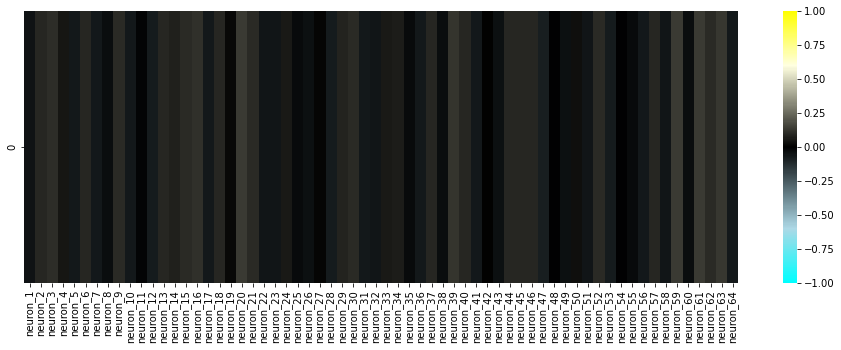

In [67]:
# NOTE: jupyter notebook mode
%matplotlib inline

import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap

boundaries = [0.0, 0.05, 0.1, 0.25, 0.5, 0.75, 0.9, 1.0]  # custom boundaries

# here I generated twice as many colors, 
# so that I could prune the boundaries more clearly
hex_colors = sns.light_palette('navy', n_colors=len(boundaries) * 2 + 2, as_cmap=False).as_hex()
hex_colors = [hex_colors[i] for i in range(0, len(hex_colors), 2)]

colors = [[norm(-1.0), "cyan"],
          [norm(-0.6), "lightblue"],
          [norm(0.0), "black"],
          [norm( 0.6), "lightyellow"],
          [norm( 1.0), "yellow"]]

custom_color_map = LinearSegmentedColormap.from_list(
    "",
    colors=colors,
)

plt.figure(figsize=(16,5))
ax = sns.heatmap(
        vmin=-1.0,
        vmax=1.0,
        data=data,
        cmap=custom_color_map,
  )
fig = ax.get_figure()
fig.savefig('./fig.png')

**Essayer de ranger les activations**

In [20]:
for cat in pop_cat:

    print(f"Activation heatmap for {cat}")
    data = [go.Heatmap(
                z=pd.DataFrame(getCatDF(cat)).iloc[:, 3:],
                colorscale=['rgb(13, 204, 223)', 'rgb(0, 0, 0)', 'rgb(205, 255, 0)'], 
                reversescale=False, 
                colorbar=dict(thickness=20,
                                ticklen=3, tickcolor='white',
                                tickfont=dict(size=14, color='white')))]

    layout = go.Layout(template='none')
    fig = go.Figure(data=data, layout=layout)
    fig.show()

Activation heatmap for American_films


Activation heatmap for Cinema_of_the_United_States


Activation heatmap for English-language_films


Activation heatmap for British_films


Activation heatmap for Warner_Bros._films


Activation heatmap for Films_based_on_American_novels


Activation heatmap for North_American_films_by_country


Activation heatmap for Films_by_country


Activation heatmap for Films_by_language


Activation heatmap for Works_by_American_people


Activation heatmap for Films_by_director


Activation heatmap for English-language_works


Activation heatmap for Films_set_in_New_York_City


Activation heatmap for American_films_by_studio


Activation heatmap for Film_scores_by_composer


Activation heatmap for Films_by_American_directors


Activation heatmap for American_drama_films


Activation heatmap for French_films


Activation heatmap for American_black-and-white_films


Activation heatmap for 20th_Century_Fox_films


Activation heatmap for American_independent_films


Activation heatmap for Metro-Goldwyn-Mayer_films


Activation heatmap for Films_shot_in_Los_Angeles


In [21]:
getCatDF('French_films').iloc[:, 3:]

,neuron_1,neuron_2,neuron_3,neuron_4,neuron_5,neuron_6,neuron_7,neuron_8,neuron_9,neuron_10,...,neuron_55,neuron_56,neuron_57,neuron_58,neuron_59,neuron_60,neuron_61,neuron_62,neuron_63,neuron_64
83,-1.296672,1.077671,1.088643,0.851263,-1.008393,1.154814,-0.652056,-0.869792,1.737952,-0.557207,...,-1.273226,-0.575973,1.728927,-0.582029,0.073745,-1.155401,1.063861,1.623576,1.136609,-0.603583
169,0.153218,-0.691040,0.039497,-0.079291,0.305861,-0.574624,-0.186713,-0.694786,-0.707213,-0.217363,...,0.037971,-0.280546,-0.667848,-0.582029,-1.189475,0.154713,-0.755206,-0.362786,-0.450347,-0.376346
206,0.478051,-0.691040,-0.166025,-0.068524,0.622146,-0.660306,0.133551,-0.272674,-0.707213,-0.010735,...,0.273110,-0.061912,-0.726233,-0.264283,-1.189475,0.398304,-0.814571,-0.517928,-0.589130,0.033825
219,-1.296672,0.353335,-0.924749,-0.749426,-1.008393,0.167372,-0.652056,-0.869792,0.528316,-0.557207,...,-1.273226,-0.575973,0.324748,-0.582029,0.766152,-1.155401,-0.131687,-0.085886,-0.547255,-0.603583
223,0.540394,-0.691040,-0.550384,0.173823,0.892749,-0.660306,0.983777,0.445026,-0.707213,1.114442,...,0.444524,0.894139,-0.726233,0.791713,-1.189475,0.529096,-1.456143,-0.695902,-0.954730,0.954172
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10918,0.096929,-0.691040,0.011393,-0.077640,0.256763,-0.559493,-0.168958,-0.744595,-0.707213,-0.181332,...,-0.006492,-0.294500,-0.654530,-0.582029,-1.189475,0.101451,-0.795108,-0.361817,-0.481216,-0.388698
10952,0.585521,-0.691040,-0.752910,-0.749426,-0.400684,-0.660306,-0.652056,1.224169,-0.707213,-0.557207,...,1.081468,-0.575973,-0.726233,-0.582029,1.622657,0.452169,0.163910,-0.776722,-0.181768,-0.510080
11114,0.576191,-0.691040,-0.269942,-0.749426,0.103743,-0.660306,-0.616076,0.474968,-0.707213,-0.557207,...,1.018392,-0.575973,-0.726233,-0.558374,0.962065,0.689568,0.304969,-0.681309,-0.033351,-0.603583
11142,0.730764,-0.691040,-0.224263,0.205644,0.736011,-0.660306,1.017483,0.680264,-0.707213,0.999164,...,0.641969,1.331516,-0.726233,0.655003,-1.189475,0.696659,-1.328064,-0.493965,-0.533510,0.921350


## Significativity of the difference between a category and the rest

We're using a t-test to estimate the significative difference for each neuron between a category and the rest of the categories. Still among the popular ones

In [17]:
from scipy import stats

Example for *French_films*

In [18]:
c = 'French_films'

Here, the mean activations for a category

In [19]:
activ_c = get_mean_activ_for_cat(c)
activ_c

,neuron_1,neuron_2,neuron_3,neuron_4,neuron_5,neuron_6,neuron_7,neuron_8,neuron_9,neuron_10,...,neuron_55,neuron_56,neuron_57,neuron_58,neuron_59,neuron_60,neuron_61,neuron_62,neuron_63,neuron_64
0,0.100403,-0.266562,-0.094113,-0.16651,0.077418,-0.240353,-0.122913,-0.094697,-0.270927,-0.147301,...,0.096099,-0.152784,-0.254604,-0.174015,-0.167328,0.085462,-0.168997,-0.209522,-0.163947,-0.155586


And there, the mean activations for all categories except *c*

In [20]:
activ_not_c = pd.DataFrame(get_activation_except_cat(c, pop_cat).mean()).T

We have to cast to np.array

In [21]:
stats.ttest_ind(np.array(activ_c)[0], np.array(activ_not_c)[0])

Ttest_indResult(statistic=-6.211291958383536, pvalue=7.0308109446979554e-09)

So, we built a function getting mean activations for the specified category and the rest of those and then compute the p-value to return it

In [22]:
def find_p(category):
    activ_c = get_mean_activ_for_cat(category)
    activ_not_c = pd.DataFrame(get_activation_except_cat(category, pop_cat).mean()).T
    
    return stats.ttest_ind(
        np.array(activ_c)[0], 
        np.array(activ_not_c)[0]
    ).pvalue

We can, then for each category among the popular ones, insert the p-value in a DataFrame and the boolean representing its significativity comparated to the other categories.

H0 : No significative difference

H1 : There is a significative difference

Then, it's significative when p-value < 0.05

**Activations du neurone dans cat x et neurone hors cat x**

In [23]:
n_cat = len(pop_cat)
p_value_matrix = np.zeros((n_cat, 2))
df_p_value = pd.DataFrame(p_value_matrix, columns=['pvalue_other_cats', 'significative'], index=pop_cat)

for cat in pop_cat:
    pvalue = find_p(cat)
    df_p_value['pvalue_other_cats'][cat] = pvalue
    if pvalue < 0.05:
        df_p_value['significative'][cat] = True
    else:
        df_p_value['significative'][cat] = False

df_p_value

C:\Users\maxim\AppData\Local\Temp/ipykernel_6976/1510388402.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,pvalue_other_cats,significative
American_films,3.083288e-01,False
Cinema_of_the_United_States,9.909902e-01,False
English-language_films,3.563127e-01,False
British_films,1.649945e-07,True
Warner_Bros._films,4.144723e-01,False
Films_based_on_American_novels,9.943952e-01,False
North_American_films_by_country,2.121556e-01,False
Films_by_country,4.453554e-03,True
Films_by_language,1.122936e-05,True
Works_by_American_people,4.008752e-01,False


In [24]:
px.scatter(df_p_value, x="pvalue_other_cats", color="significative")

In [25]:
df_p_value.describe()

,pvalue_other_cats
count,2.300000e+01
mean,3.148743e-01
std,3.147538e-01
min,7.030811e-09
25%,3.627596e-02
50%,3.057755e-01
75%,4.048383e-01
max,9.943952e-01


We want to plot a heatmap of the p-value for each category

In [26]:
pd.DataFrame(df_p_value['pvalue_other_cats']).T

,American_films,Cinema_of_the_United_States,English-language_films,British_films,Warner_Bros._films,Films_based_on_American_novels,North_American_films_by_country,Films_by_country,Films_by_language,Works_by_American_people,...,American_films_by_studio,Film_scores_by_composer,Films_by_American_directors,American_drama_films,French_films,American_black-and-white_films,20th_Century_Fox_films,American_independent_films,Metro-Goldwyn-Mayer_films,Films_shot_in_Los_Angeles
pvalue_other_cats,0.308329,0.99099,0.356313,1.649945e-07,0.414472,0.994395,0.212156,0.004454,0.000011,0.400875,...,0.362293,0.232229,0.333302,0.069959,7.030811e-09,0.408801,0.168024,0.718893,0.005211,0.883074


We finally plot the heatmap for the p-values we just got. The most is blue, the most the category in question is significatively different.

An issue is that we **don't know** which category we're looking if we just refer at the heatmap

In [27]:
print(f"P-values heatmap")
data = [go.Heatmap(
            z=pd.DataFrame(df_p_value['pvalue_other_cats']).T,
            colorscale=['rgb(13, 204, 223)', 'rgb(0, 0, 0)', 'rgb(205, 255, 0)'], 
            reversescale=False, 
            colorbar=dict(thickness=20,
                          ticklen=3, tickcolor='white',
                          tickfont=dict(size=14, color='white')))]

layout = go.Layout(template='none')
fig = go.Figure(data=data, layout=layout)
fig.show()

P-values heatmap


### Similarity between 2 categories

We'll use 2 techniques to determine the similarity between 2 categories. Indeed, mean activations for a category can totally be represented as a vector.
- Euclidean distance
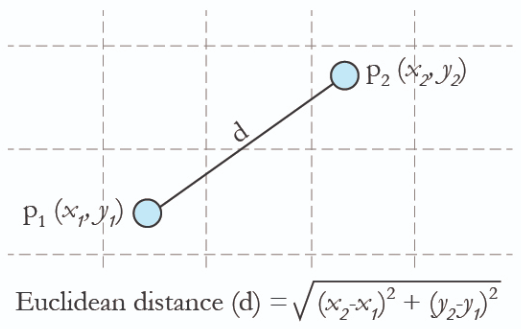

- Cosine similarity
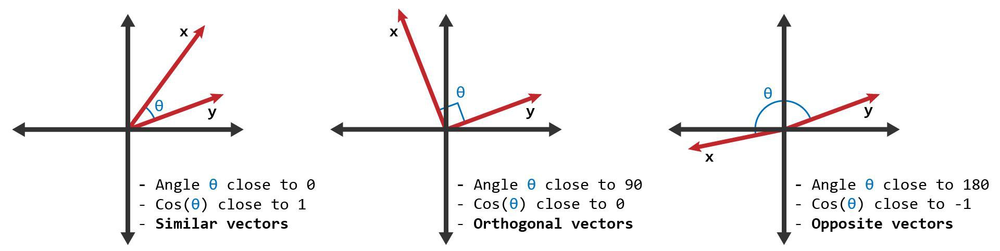

#### Euclidean distance

In [28]:
c1 = np.array(get_mean_activ_for_cat('French_films'))
c1

array([[ 1.0040304e-01, -2.6656172e-01, -9.4112694e-02, -1.6651011e-01,
         7.7417515e-02, -2.4035273e-01, -1.2291328e-01, -9.4697110e-02,
        -2.7092713e-01, -1.4730150e-01,  3.3841606e-02, -6.2877163e-02,
        -3.5121801e-01, -2.5617188e-01, -2.5730228e-01, -2.5281298e-01,
        -1.7949021e-01, -2.5389963e-01,  1.0776030e-01, -1.5705192e-01,
        -2.5588110e-01, -1.4208676e-01, -1.5662220e-01,  4.2056028e-02,
        -1.6565509e-04,  1.1521074e-01,  2.5543869e-01, -1.6383021e-01,
        -2.4292421e-01, -2.6502559e-01, -1.2052497e-01, -1.1125197e-01,
        -2.2074464e-01, -2.7919796e-01,  2.0666420e-02, -1.5731391e-01,
        -2.6240358e-01, -1.8912243e-02, -1.0499306e-01, -2.5354376e-01,
        -1.0956996e-01,  2.4985269e-01,  2.1764220e-01, -2.7567020e-01,
        -2.4336167e-01, -2.6700452e-01, -1.1185832e-01,  1.1114243e-02,
        -5.4825261e-02,  2.0395929e-01, -1.5313084e-01, -2.4294849e-01,
        -1.0275448e-01,  1.5495035e-01,  9.6098512e-02, -1.52783

In [29]:
c2 = np.array(get_mean_activ_for_cat('American_films'))
c2

array([[-0.05069523,  0.09211248,  0.10567152,  0.05423556, -0.0667548 ,
         0.09174331, -0.06843688, -0.03258617,  0.09405614, -0.06582028,
        -0.01203707, -0.07165182,  0.08930755,  0.07750602,  0.09390633,
         0.11088161, -0.06430247,  0.09033276,  0.02016913,  0.13826887,
         0.09976815, -0.05968273, -0.06075047,  0.05538462, -0.02524916,
        -0.0409507 ,  0.01316301, -0.07120257,  0.08369607,  0.10086166,
        -0.06891247, -0.062286  ,  0.05901731,  0.06762767, -0.02910561,
        -0.06499519,  0.0873358 , -0.03875703,  0.12122869,  0.09282062,
        -0.06743435,  0.00337856, -0.03948192,  0.08624859,  0.08944933,
         0.08717918, -0.07966206, -0.00440368, -0.04398013,  0.03181161,
        -0.06127544,  0.10094102, -0.07375392, -0.003454  , -0.02507155,
        -0.06852669,  0.09309841, -0.0560808 ,  0.13658176, -0.03357209,
         0.13969561,  0.10019868,  0.13273562, -0.0641315 ]],
      dtype=float32)

Where a & b are vectors (numpy arrays), we can compute the euclidean distance with 
```python
dist = numpy.linalg.norm(a-b)
```

In [30]:
import numpy as np

e_dist = np.linalg.norm(c1 - c2)
e_dist

1.8766742

Then, we make a function:

In [31]:
def get_euclidean_distance(arr1, arr2):
    "@ arr1 & arr2 are supposed to be numpy arrays"
    return np.linalg.norm(arr1 - arr2)

In [32]:
get_euclidean_distance(get_mean_activ_for_cat("French_films"), get_mean_activ_for_cat("American_films"))

1.8766742

#### Cosine similarity

We still have c1 & c2

In [33]:
c1

array([[ 1.0040304e-01, -2.6656172e-01, -9.4112694e-02, -1.6651011e-01,
         7.7417515e-02, -2.4035273e-01, -1.2291328e-01, -9.4697110e-02,
        -2.7092713e-01, -1.4730150e-01,  3.3841606e-02, -6.2877163e-02,
        -3.5121801e-01, -2.5617188e-01, -2.5730228e-01, -2.5281298e-01,
        -1.7949021e-01, -2.5389963e-01,  1.0776030e-01, -1.5705192e-01,
        -2.5588110e-01, -1.4208676e-01, -1.5662220e-01,  4.2056028e-02,
        -1.6565509e-04,  1.1521074e-01,  2.5543869e-01, -1.6383021e-01,
        -2.4292421e-01, -2.6502559e-01, -1.2052497e-01, -1.1125197e-01,
        -2.2074464e-01, -2.7919796e-01,  2.0666420e-02, -1.5731391e-01,
        -2.6240358e-01, -1.8912243e-02, -1.0499306e-01, -2.5354376e-01,
        -1.0956996e-01,  2.4985269e-01,  2.1764220e-01, -2.7567020e-01,
        -2.4336167e-01, -2.6700452e-01, -1.1185832e-01,  1.1114243e-02,
        -5.4825261e-02,  2.0395929e-01, -1.5313084e-01, -2.4294849e-01,
        -1.0275448e-01,  1.5495035e-01,  9.6098512e-02, -1.52783

In [34]:
c2

array([[-0.05069523,  0.09211248,  0.10567152,  0.05423556, -0.0667548 ,
         0.09174331, -0.06843688, -0.03258617,  0.09405614, -0.06582028,
        -0.01203707, -0.07165182,  0.08930755,  0.07750602,  0.09390633,
         0.11088161, -0.06430247,  0.09033276,  0.02016913,  0.13826887,
         0.09976815, -0.05968273, -0.06075047,  0.05538462, -0.02524916,
        -0.0409507 ,  0.01316301, -0.07120257,  0.08369607,  0.10086166,
        -0.06891247, -0.062286  ,  0.05901731,  0.06762767, -0.02910561,
        -0.06499519,  0.0873358 , -0.03875703,  0.12122869,  0.09282062,
        -0.06743435,  0.00337856, -0.03948192,  0.08624859,  0.08944933,
         0.08717918, -0.07966206, -0.00440368, -0.04398013,  0.03181161,
        -0.06127544,  0.10094102, -0.07375392, -0.003454  , -0.02507155,
        -0.06852669,  0.09309841, -0.0560808 ,  0.13658176, -0.03357209,
         0.13969561,  0.10019868,  0.13273562, -0.0641315 ]],
      dtype=float32)

In [35]:
from scipy import spatial

In [36]:
result = 1 - spatial.distance.cosine(c1, c2)
result

-0.5107682943344116

We, again, make a function

In [37]:
def cosine_similarity(cat1, cat2):
    c1 = np.array(get_mean_activ_for_cat(cat1))
    c2 = np.array(get_mean_activ_for_cat(cat2))
    return 1 - spatial.distance.cosine(c1, c2)

In [38]:
cosine_similarity('French_films', 'Films_by_director')

-0.18273252248764038

In [39]:
def cosine_similarity_matrix(categories):
    n = len(categories)
    matrix = pd.DataFrame(np.zeros((n, n)), columns=categories, index=categories)
    for cat in categories:
        for _cat in categories:
            matrix[cat][_cat] = cosine_similarity(cat, _cat)
            
    return matrix

In [40]:
m = cosine_similarity_matrix(pop_cat)
m.head()

,American_films,Cinema_of_the_United_States,English-language_films,British_films,Warner_Bros._films,Films_based_on_American_novels,North_American_films_by_country,Films_by_country,Films_by_language,Works_by_American_people,...,American_films_by_studio,Film_scores_by_composer,Films_by_American_directors,American_drama_films,French_films,American_black-and-white_films,20th_Century_Fox_films,American_independent_films,Metro-Goldwyn-Mayer_films,Films_shot_in_Los_Angeles
American_films,1.000000,0.159722,-0.585052,-0.345250,0.881586,0.270895,0.895227,-0.821338,-0.322126,0.917973,...,0.914347,0.886950,0.777786,-0.762346,-0.510768,-0.674825,0.879886,-0.820765,-0.285493,0.899334
Cinema_of_the_United_States,0.159722,1.000000,0.411589,0.024882,-0.018348,0.625455,-0.142892,0.166043,-0.049534,-0.048042,...,0.032692,0.043787,0.131533,0.200257,0.173122,0.281104,0.259242,0.198693,0.595639,-0.110224
English-language_films,-0.585052,0.411589,1.000000,0.534660,-0.855573,0.365669,-0.803509,0.739836,0.206823,-0.806897,...,-0.786152,-0.831809,-0.749705,0.945109,0.374727,0.928004,-0.602626,0.919547,0.905357,-0.868589
British_films,-0.345250,0.024882,0.534660,1.000000,-0.510906,-0.366861,-0.231365,0.032564,-0.583743,-0.311279,...,-0.320080,-0.560210,-0.387603,0.623216,-0.480078,0.327895,-0.693852,0.428558,0.381481,-0.420343
Warner_Bros._films,0.881586,-0.018348,-0.855573,-0.510906,1.000000,-0.034233,0.920587,-0.852891,-0.314144,0.957198,...,0.969296,0.990711,0.938238,-0.962268,-0.470356,-0.911313,0.866936,-0.958904,-0.651530,0.979449


In [41]:
m.describe()

,American_films,Cinema_of_the_United_States,English-language_films,British_films,Warner_Bros._films,Films_based_on_American_novels,North_American_films_by_country,Films_by_country,Films_by_language,Works_by_American_people,...,American_films_by_studio,Film_scores_by_composer,Films_by_American_directors,American_drama_films,French_films,American_black-and-white_films,20th_Century_Fox_films,American_independent_films,Metro-Goldwyn-Mayer_films,Films_shot_in_Los_Angeles
count,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,...,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000,23.000000
mean,0.178293,0.218972,0.047616,-0.059614,0.093032,0.240321,0.071331,-0.042737,0.003134,0.091969,...,0.101721,0.110859,0.091856,-0.035620,0.004736,0.015737,0.189716,-0.034423,0.139900,0.075954
std,0.697103,0.282432,0.764678,0.487560,0.808230,0.331090,0.785981,0.761129,0.467752,0.798322,...,0.798635,0.791643,0.755821,0.803069,0.559621,0.799196,0.656926,0.814273,0.650359,0.812365
min,-0.821338,-0.142892,-0.868589,-0.693852,-0.962268,-0.366861,-0.966238,-0.966238,-0.583743,-0.952534,...,-0.948158,-0.953329,-0.892676,-0.962268,-0.695153,-0.912227,-0.806491,-0.980237,-0.653805,-0.980237
25%,-0.428009,0.028787,-0.794830,-0.450210,-0.618042,-0.062388,-0.642829,-0.823447,-0.359123,-0.613526,...,-0.613765,-0.581773,-0.571240,-0.886524,-0.495423,-0.886702,-0.453162,-0.930834,-0.589341,-0.629166
50%,0.159722,0.166043,0.365669,-0.311279,-0.034233,0.270895,-0.140068,0.085370,-0.049534,-0.080115,...,-0.076408,0.043787,-0.118894,0.187264,-0.109111,0.327895,0.259242,0.215564,0.375217,-0.110224
75%,0.884268,0.346347,0.799402,0.405020,0.947718,0.480194,0.894435,0.696455,0.299618,0.936309,...,0.953663,0.932260,0.877493,0.751847,0.435764,0.791586,0.805963,0.720270,0.752892,0.956237
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [42]:
print(f"Cosine similarities")
data = [go.Heatmap(
            z=m,
            colorscale=['rgb(13, 204, 223)', 'rgb(0, 0, 0)', 'rgb(205, 255, 0)'], 
            reversescale=False, 
            colorbar=dict(thickness=20,
                          ticklen=3, tickcolor='white',
                          tickfont=dict(size=14, color='white')))]

layout = go.Layout(template='none')
fig = go.Figure(data=data, layout=layout)
fig.show()

Cosine similarities


MH : I'd rather go with this one below

**Essayer d'ordonner les catégories**

In [45]:
fig = px.imshow(m, title=f"Cosine similarities", height=750, width=750)
# fig.write_image('./plots/cosine-sim-matrix.png') # Make the cell not working (running for infinite)
fig.show()

Make a representativity score for each category. This score would be high when activations are significative enough to be distincted from others on a heatmap

Thus, we take again the p-values with *df_p_value* and we'll interpret this data

In [42]:
df_p_value.describe()

,pvalue_other_cats
count,2.300000e+01
mean,3.148743e-01
std,3.147538e-01
min,7.030811e-09
25%,3.627596e-02
50%,3.057755e-01
75%,4.048383e-01
max,9.943952e-01


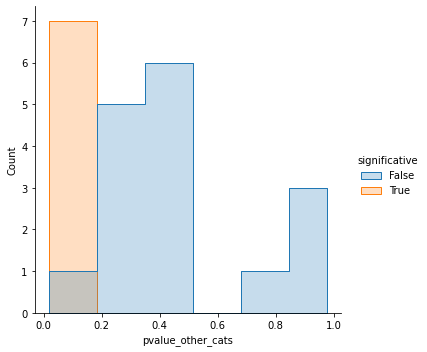

In [43]:
import seaborn as sns

sns.displot(df_p_value, x="pvalue_other_cats", 
            shrink=.8, hue="significative", element="step")

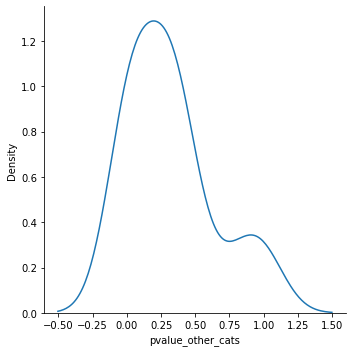

In [44]:
sns.displot(df_p_value, x="pvalue_other_cats", kind="kde")

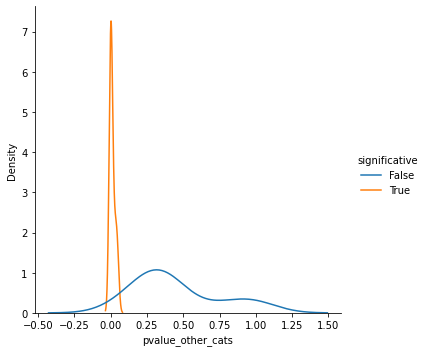

In [45]:
sns.displot(df_p_value, x="pvalue_other_cats", 
            kind="kde", hue="significative")

Only plot the significative ones

In [46]:
df_p_sign = df_p_value[df_p_value.significative == True]
df_p_sign.head()

,pvalue_other_cats,significative
British_films,1.649945e-07,True
Films_by_country,4.453554e-03,True
Films_by_language,1.122936e-05,True
Films_by_director,2.732684e-02,True
English-language_works,4.522508e-02,True


In [47]:
df_p_sign.describe()

,pvalue_other_cats
count,7.000000e+00
mean,1.174683e-02
std,1.766888e-02
min,7.030811e-09
25%,5.697179e-06
50%,4.453554e-03
75%,1.626889e-02
max,4.522508e-02


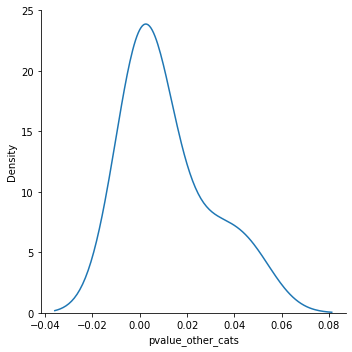

In [48]:
sns.displot(df_p_sign, x="pvalue_other_cats", kind="kde")

In [49]:
df_p_value["zscore"] = (df_p_value.pvalue_other_cats - df_p_value.pvalue_other_cats.mean()) / df_p_value.pvalue_other_cats.std()

In [50]:
df_p_value

,pvalue_other_cats,significative,zscore
American_films,3.083288e-01,False,-0.020795
Cinema_of_the_United_States,9.909902e-01,False,2.148078
English-language_films,3.563127e-01,False,0.131653
British_films,1.649945e-07,True,-1.000382
Warner_Bros._films,4.144723e-01,False,0.316432
Films_based_on_American_novels,9.943952e-01,False,2.158896
North_American_films_by_country,2.121556e-01,False,-0.326346
Films_by_country,4.453554e-03,True,-0.986233
Films_by_language,1.122936e-05,True,-1.000347
Works_by_American_people,4.008752e-01,False,0.273232


Computing a significativeness score based on the p-values.

$$(1 - pvalue) * 100$$

In [48]:
df_p_value["significativeness_score"] = (1 - df_p_value.pvalue_other_cats) * 100

In [49]:
df_p_value

,pvalue_other_cats,significative,significativeness_score
American_films,3.083288e-01,False,69.167119
Cinema_of_the_United_States,9.909902e-01,False,0.900983
English-language_films,3.563127e-01,False,64.368733
British_films,1.649945e-07,True,99.999984
Warner_Bros._films,4.144723e-01,False,58.552766
Films_based_on_American_novels,9.943952e-01,False,0.560478
North_American_films_by_country,2.121556e-01,False,78.784444
Films_by_country,4.453554e-03,True,99.554645
Films_by_language,1.122936e-05,True,99.998877
Works_by_American_people,4.008752e-01,False,59.912483


We can see on these plots below that the significativeness score is well computed based on the p-values

In [57]:
fig = px.scatter(df_p_value, x="pvalue_other_cats", color="significative", height=400, width=800)
fig.show()

fig = px.scatter(df_p_value, x="significativeness_score", color="significative", height=400, width=800)
fig.show()